In [2]:
import cv2
import matplotlib.pyplot as plt

import numpy as np
import pandas as pd
import seaborn as sns
import scipy.stats as stats

import sys
from pathlib import Path
current_script_path = Path().resolve()

functions_dir = current_script_path.parents[0] / 'Functions'
sys.path.insert(0, str(functions_dir))
print(functions_dir)
import mouse as mouse

ssm_dir = current_script_path.parents[1] / 'SSM'
sys.path.insert(0, str(ssm_dir))
print(ssm_dir)
import ssm as ssm
from ssm.plots import gradient_cmap

aeon_mecha_dir = current_script_path.parents[1] / 'aeon_mecha' 
sys.path.insert(0, str(aeon_mecha_dir))
print(aeon_mecha_dir)
import aeon
import aeon.io.api as api
from aeon.io import reader, video
from aeon.schema.schemas import social02
from aeon.schema.dataset import exp02
from aeon.schema.schemas import social02
from aeon.analysis.utils import visits, distancetravelled

LABELS = [
    ['AEON3', 'Pre','BAA-1104045'],
    ['AEON3', 'Pre','BAA-1104047'],
    ['AEON3', 'Post','BAA-1104045'],
    ['AEON3', 'Post','BAA-1104047'],
    ['AEON4', 'Pre','BAA-1104048'], 
    ['AEON4', 'Pre','BAA-1104049'],
    ['AEON4', 'Post','BAA-1104048'],
    ['AEON4', 'Post','BAA-1104049']
]
nodes_name = ['nose', 'head', 'right_ear', 'left_ear', 'spine1', 'spine2','spine3', 'spine4']
color_names = [
    'black', 'blue', 'red', 'tan', 'green', 'brown', 
    'purple', 'orange', 'turquoise', 'yellow', 'pink', 
    'darkblue', 'lime', 'cyan', 'magenta', 'gold', 
    'navy', 'maroon', 'teal', 'grey'
]

2024-08-16 18:34:27.177393: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /nfs/nhome/live/zimol/.local/lib/python3.9/site-packages/cv2/../../lib64:
2024-08-16 18:34:27.177475: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


/nfs/nhome/live/zimol/ProjectAeon/Code/Functions
/nfs/nhome/live/zimol/ProjectAeon/SSM
/nfs/nhome/live/zimol/ProjectAeon/aeon_mecha


In [3]:
Mouse = mouse.Mouse(aeon_exp = 'AEON3', type = 'Pre', mouse = 'BAA-1104045')
color_names = [
    'black', 'blue', 'red', 'tan', 'green', 'brown', 
    'purple', 'orange', 'magenta', 'olive', 'pink', 
    'darkblue', 'lime', 'cyan', 'magenta', 'gold', 
    'navy', 'maroon', 'teal', 'grey'
]
Mouse.Run_Visits()

NODES = [['head', 'spine3'],['spine1', 'spine3'],['left_ear', 'spine3'],['right_ear', 'spine3']]
for nodes in NODES:
    Mouse.Add_Body_Info_to_mouse_pos(property = 'distance', nodes = nodes)
Mouse.hmm.Get_States(n_state = 10, feature = 'Kinematics_and_Body')
Mouse.mouse_pos['state'] = Mouse.hmm.states

Get_Visits Completed


In [21]:
starts, ends = [], []
states = Mouse.hmm.states + 1
for i in range(1,len(states)-1):
    if states[i] == 5 and states[i-1] != 5: starts.append(i)
    if states[i] == 5 and states[i+1] != 5: ends.append(i)

idx = []
for i in range(len(starts)):
    if ends[i] - starts[i] > 30 and Mouse.mouse_pos['r'][starts[i]] < Mouse.arena.radius: # and Mouse.mouse_pos['smoothed_position_x'][starts[i]] > 1250: #<210
        idx.append(starts[i])
print(len(idx))

9


In [22]:
idx

[812695, 849618, 1004992, 1025180, 1582605, 1612417, 1621792, 1649143, 1741986]

In [86]:
print(idx[::41][:-1])

[21418, 354275, 462567, 563975, 701801, 758035, 882169, 1152403, 1317760, 1465204, 1569692, 1719294, 1850512, 2033279, 2333054, 2508854]


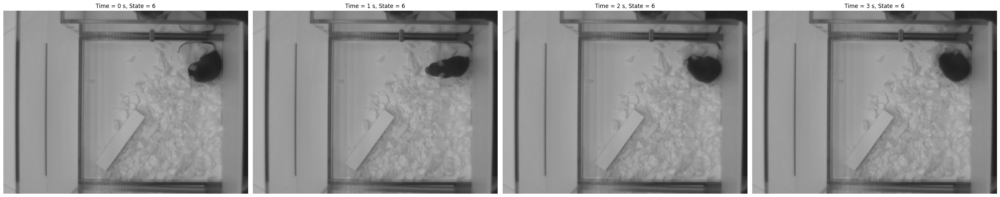

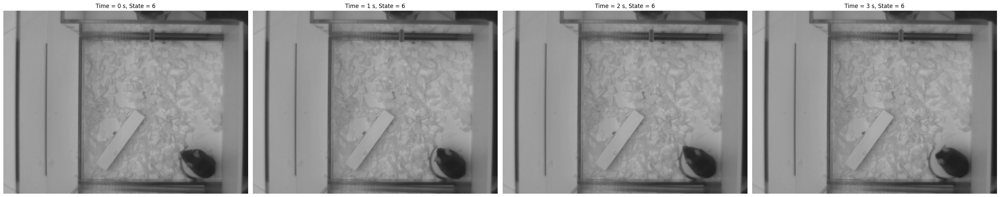

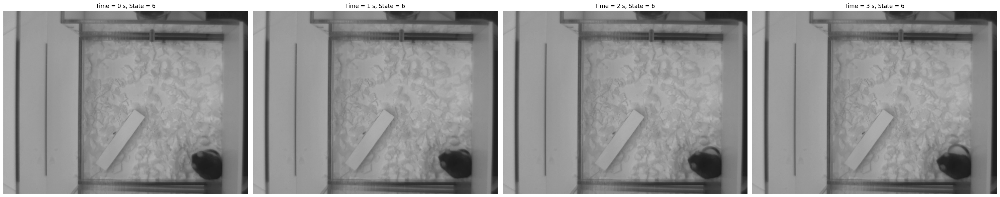

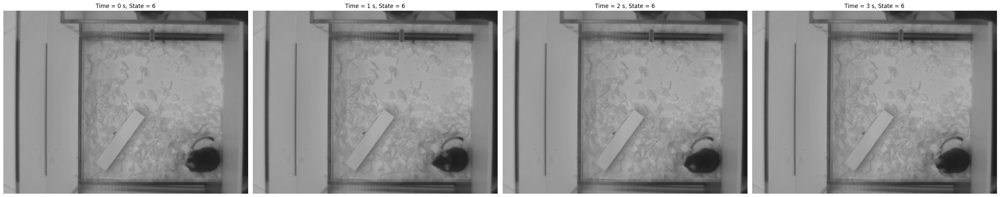

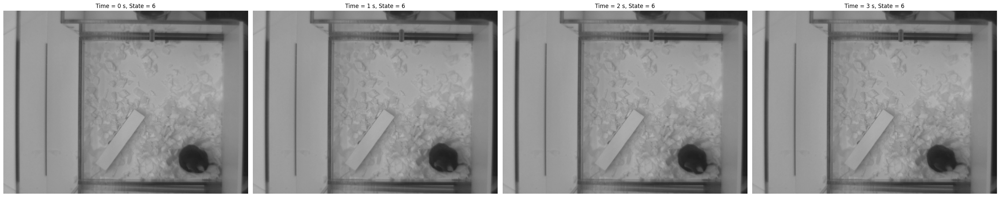

...

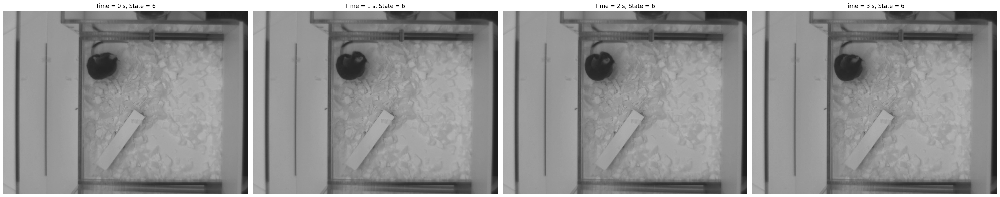

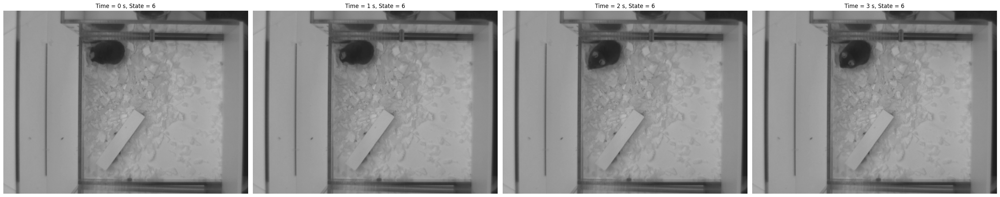

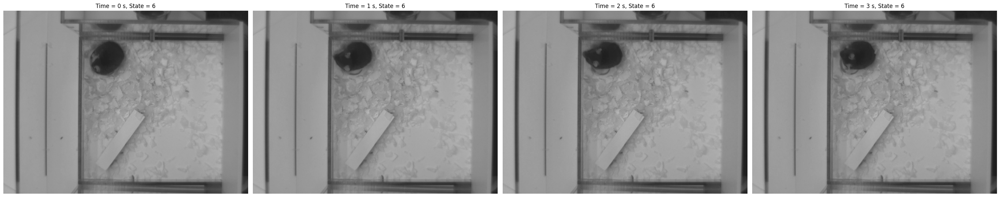

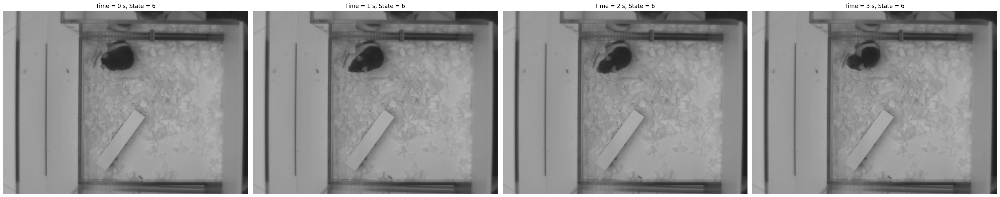

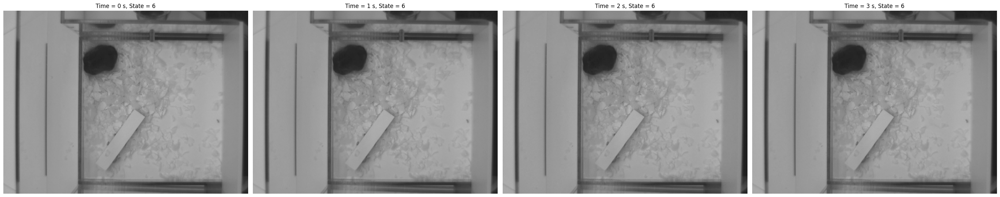

In [84]:
root = Mouse.root
states = Mouse.hmm.states + 1
Mouse.mouse_pos['state'] = pd.Series(states, index = Mouse.mouse_pos.index)

for t in idx[::41]:
    trigger = Mouse.mouse_pos.index[t]
    times = [0, 1, 2, 3]
    fig, axs = plt.subplots(1,4,figsize = (30, 8))
    for i in range(len(times)):
        time = trigger + pd.Timedelta(str(times[i]) + "S")
        start, end = time, time + pd.Timedelta("1S")
        state = Mouse.mouse_pos.loc[start:end, 'state'][0]
        video_metadata = aeon.load(root, social02.CameraNest.Video, start=start, end=end)
        video_metadata.index = video_metadata.index.round("20L")
        frames = video.frames(video_metadata)
        first_frame = next(frames)
        rgb_frame = cv2.cvtColor(first_frame, cv2.COLOR_BGR2RGB)
        axs[i].imshow(rgb_frame)
        axs[i].set_title('Time = ' + str(times[i]) + ' s, State = ' + str(state))
        axs[i].axis('off')
    plt.tight_layout()
    #plt.savefig('../Images/Introduction/ArenaState5.png')
    plt.show()

In [72]:
for t in idx:
    trigger = Mouse.mouse_pos.index[t]
    times = [0, 1, 2, 3]
    x = Mouse.mouse_pos.smoothed_position_x[t]
    y = Mouse.mouse_pos.smoothed_position_y[t]
    patch_distance = [(x-patch_loc[j][0])**2 + (y-patch_loc[j][1])**2 for j in range(3)]
    if min(patch_distance) < 2000:
        patch_idx = np.argsort(patch_distance)[0]
        patch = 'Patch' + str(patch_idx + 1)
        print(t)

25928
73874
92435
106952
108729
929296
979442
1623060
1630265
1631012
1631760


In [60]:
idx[::9][0]

106952

In [57]:
t =  idx[::9][0]
trigger = Mouse.mouse_pos.index[t]
times = [0, 1, 2, 3]
x = Mouse.mouse_pos.smoothed_position_x[t]
y = Mouse.mouse_pos.smoothed_position_y[t]
patch_distance = [(x-patch_loc[j][0])**2 + (y-patch_loc[j][1])**2 for j in range(3)]
print(patch_distance)

[145242.91330742036, 144984.37480816306, 1345.5438840500942]


In [58]:
np.sqrt(1345.5438840500942)

36.681655961121685

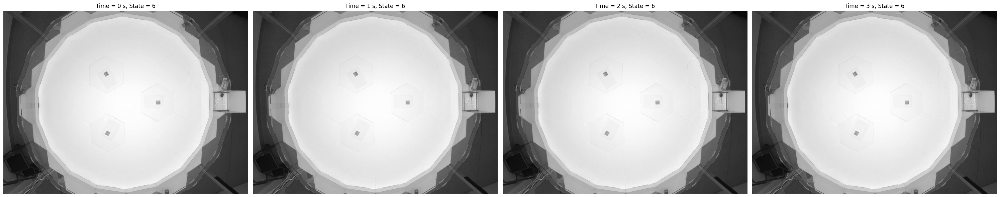

In [67]:
root = Mouse.root
states = Mouse.hmm.states + 1
Mouse.mouse_pos['state'] = pd.Series(states, index = Mouse.mouse_pos.index)
#patch_loc = [Mouse.arena.patch_location['Patch' + str(i+1)] for i in range(3)]

for t in idx[:1]:
    trigger = Mouse.mouse_pos.index[t]
    times = [0, 1, 2, 3]
    
    fig, axs = plt.subplots(1,4,figsize = (30, 8))
    for i in range(len(times)):
        time = trigger + pd.Timedelta(str(times[i]) + "S")
        start, end = time, time + pd.Timedelta("1S")
        state = Mouse.mouse_pos.loc[start:end, 'state'][0]

        video_metadata = aeon.load(root, social02.CameraTop.Video, start=start, end=end)

        video_metadata.index = video_metadata.index.round("20L")
        frames = video.frames(video_metadata)
        first_frame = next(frames)
        rgb_frame = cv2.cvtColor(first_frame, cv2.COLOR_BGR2RGB)
        axs[i].imshow(rgb_frame)
        axs[i].set_title('Time = ' + str(times[i]) + ' s, State = ' + str(state))
        axs[i].axis('off')
    plt.tight_layout()
    #plt.savefig('../Images/Introduction/ArenaState5.png')
    plt.show()

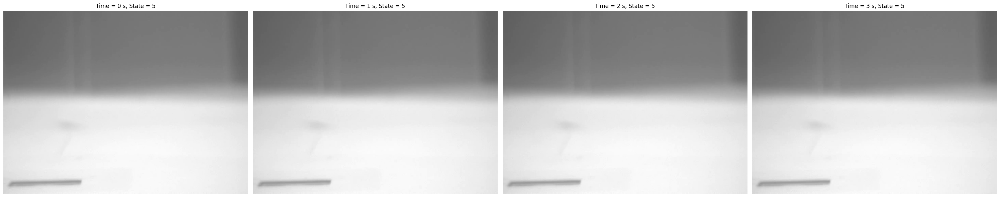

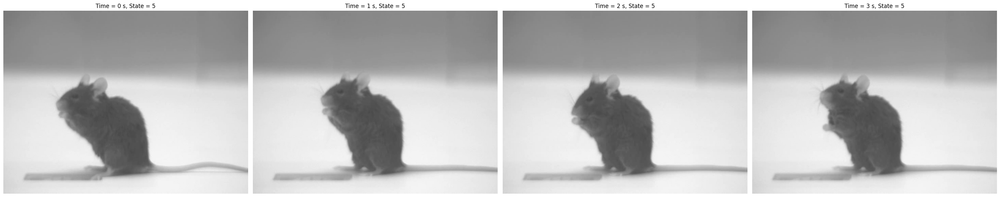

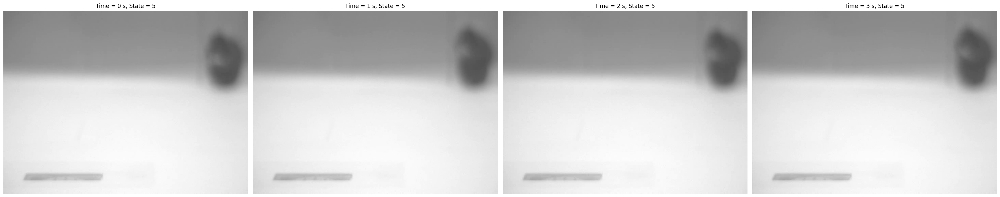

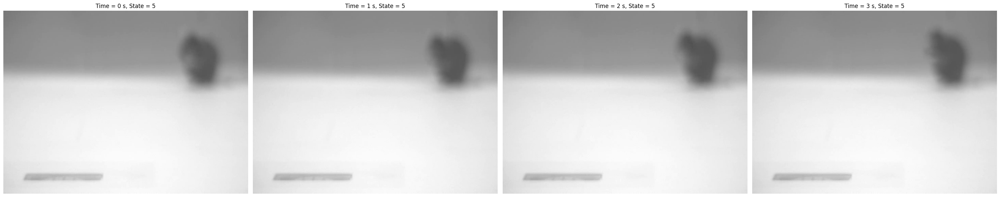

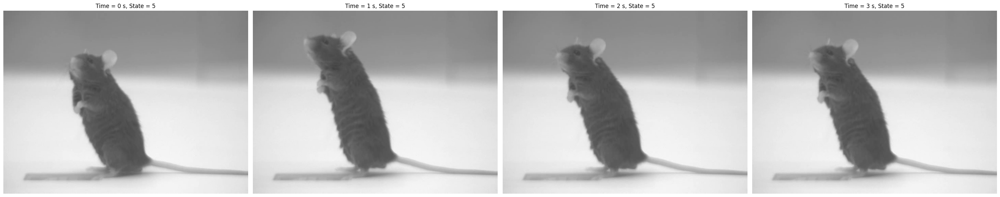

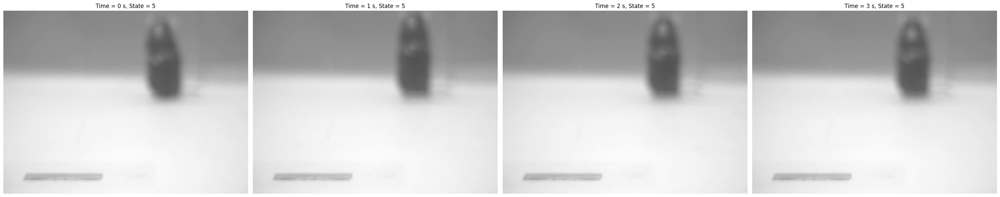

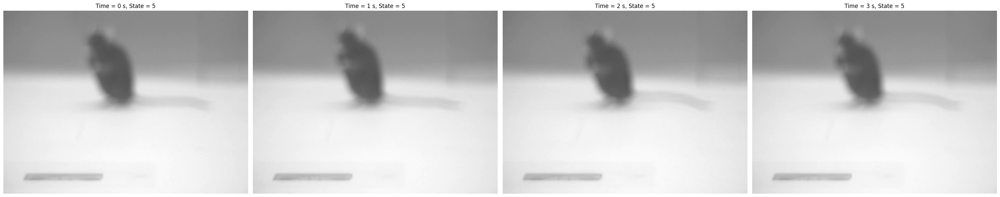

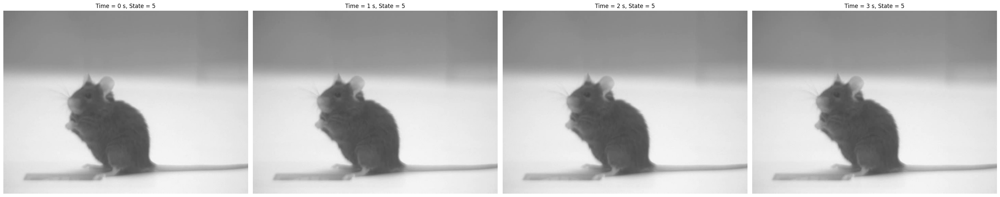

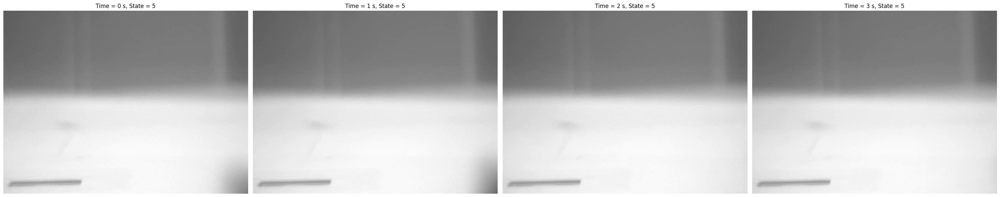

In [23]:
root = Mouse.root
states = Mouse.hmm.states + 1
Mouse.mouse_pos['state'] = pd.Series(states, index = Mouse.mouse_pos.index)
patch_loc = [Mouse.arena.patch_location['Patch' + str(i+1)] for i in range(3)]

idx_ = [812695, 849618, 1004992, 1025180, 1582605, 1612417, 1621792, 1649143, 1741986]
for t in idx_:
    trigger = Mouse.mouse_pos.index[t]
    times = [0, 1, 2, 3]
    x = Mouse.mouse_pos.smoothed_position_x[t]
    y = Mouse.mouse_pos.smoothed_position_y[t]
    patch_distance = [(x-patch_loc[j][0])**2 + (y-patch_loc[j][1])**2 for j in range(3)]
    patch_idx = np.argsort(patch_distance)[0]
    patch = 'Patch' + str(patch_idx + 1)
    
    fig, axs = plt.subplots(1,4,figsize = (30, 8))
    for i in range(len(times)):
        time = trigger + pd.Timedelta(str(times[i]) + "S")
        start, end = time, time + pd.Timedelta("1S")
        state = Mouse.mouse_pos.loc[start:end, 'state'][0]
        if patch == 'Patch1':
            video_metadata = aeon.load(root, social02.CameraPatch1.Video, start=start, end=end)
        if patch == 'Patch2':
            video_metadata = aeon.load(root, social02.CameraPatch2.Video, start=start, end=end)
        if patch == 'Patch3':
            video_metadata = aeon.load(root, social02.CameraPatch3.Video, start=start, end=end)

        video_metadata.index = video_metadata.index.round("20L")
        frames = video.frames(video_metadata)
        first_frame = next(frames)
        rgb_frame = cv2.cvtColor(first_frame, cv2.COLOR_BGR2RGB)
        axs[i].imshow(rgb_frame)
        axs[i].set_title('Time = ' + str(times[i]) + ' s, State = ' + str(state))
        axs[i].axis('off')
    plt.tight_layout()
    #plt.savefig('../Images/Introduction/ArenaState5.png')
    plt.show()

In [11]:
Mouse.mouse_pos['state'] = Mouse.hmm.states
STATES = Mouse.hmm.process_states.Event_Triggering(Mouse.mouse_pos, Mouse.arena.pellets.index, 3, 3, 'state')

In [19]:
idx = []
for i in range(len(Mouse.arena.pellets.index)):
    trigger = Mouse.arena.pellets.index[i]
    start, end = trigger, trigger + pd.Timedelta("3S")
    state = Mouse.mouse_pos.loc[start:end, 'state'][0:30].to_numpy() + 1
    if np.array_equal(state[0:12], np.array([4,4,4,4,4,4,7,7,7,7,7,7])[0:12]) and np.array_equal(state[27:], np.array([3,3,3])):
        print(state)
        idx.append(i)
print(idx)

[4 4 4 4 4 4 7 7 7 7 7 7 7 7 6 6 3 3 3 2 2 2 2 2 2 2 3 3 3 3]
[4 4 4 4 4 4 7 7 7 7 7 7 7 6 3 3 2 2 2 2 2 2 2 1 1 1 2 3 3 3]
[4 4 4 4 4 4 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 6 3 3 3 3 3 3 3]
[4 4 4 4 4 4 7 7 7 7 7 7 6 3 3 3 3 3 3 6 6 6 6 6 6 3 3 3 3 3]
[4 4 4 4 4 4 7 7 7 7 7 7 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 3 3 3]
[4 4 4 4 4 4 7 7 7 7 7 7 7 7 7 6 3 3 3 3 3 3 3 3 3 3 3 3 3 3]
[4 4 4 4 4 4 7 7 7 7 7 7 7 7 6 6 6 6 6 6 6 3 3 3 3 3 3 3 3 3]
[4 4 4 4 4 4 7 7 7 7 7 7 7 6 3 3 3 2 2 2 2 1 1 1 2 3 3 3 3 3]
[4 4 4 4 4 4 7 7 7 7 7 7 7 7 7 7 7 7 7 7 6 6 6 6 6 6 3 3 3 3]
[4 4 4 4 4 4 7 7 7 7 7 7 7 7 7 6 6 3 3 3 2 2 2 2 2 2 3 3 3 3]
[4 4 4 4 4 4 7 7 7 7 7 7 7 6 3 3 3 3 3 2 2 2 2 2 2 3 3 3 3 3]
[194, 256, 289, 336, 407, 425, 524, 581, 600, 644, 668]


In [122]:
trigger = Mouse.arena.pellets.index[550]
idx = Mouse.arena.visits['start'].searchsorted(trigger, side='right') - 1
patch = Mouse.arena.visits['patch'][idx]
print(patch)

Patch1


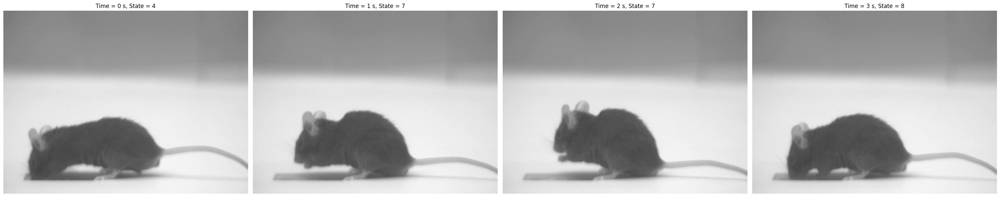

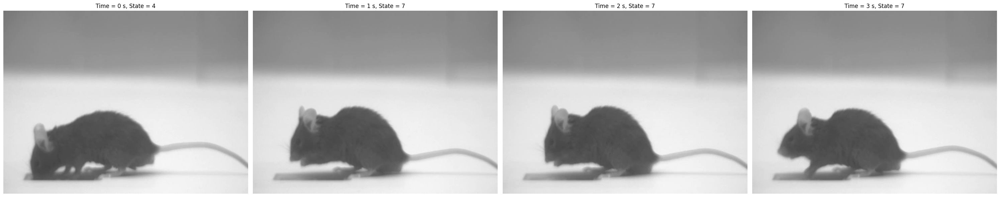

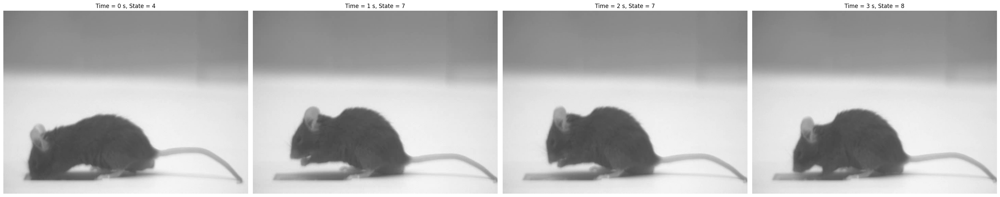

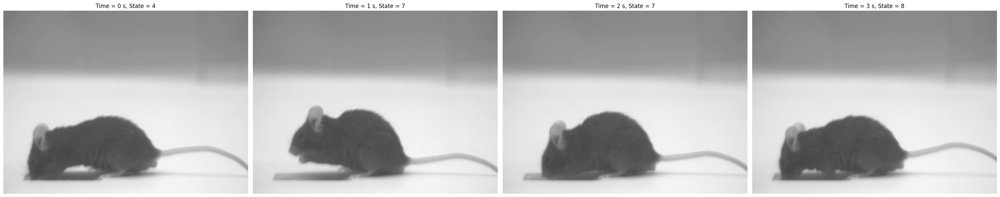

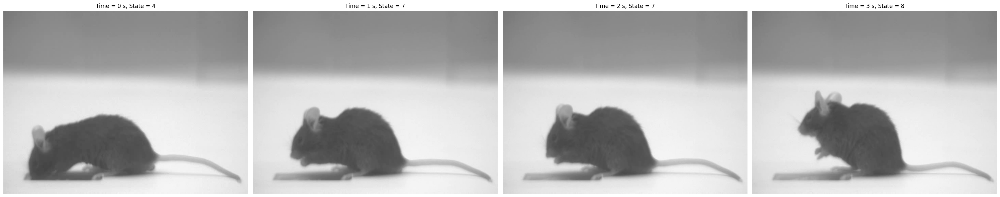

...

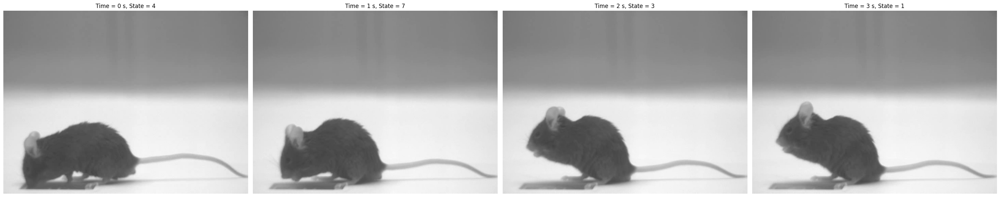

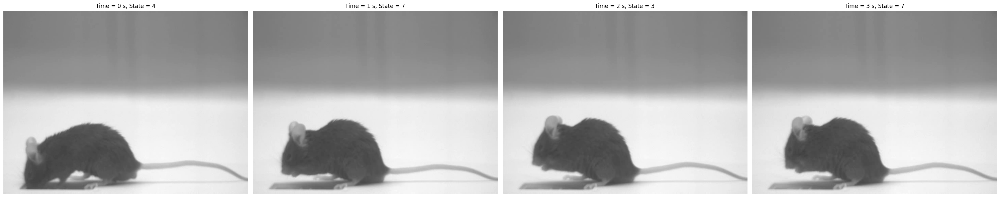

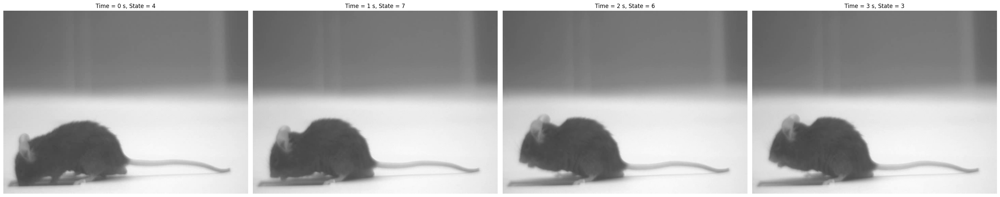

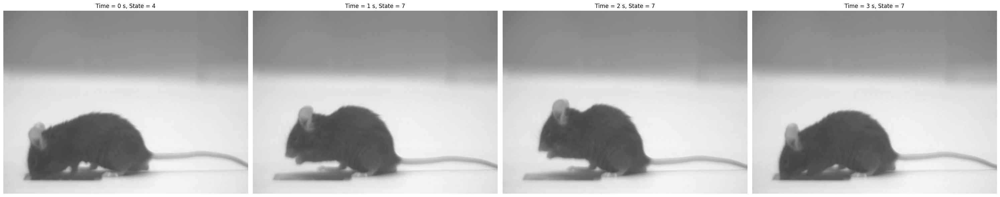

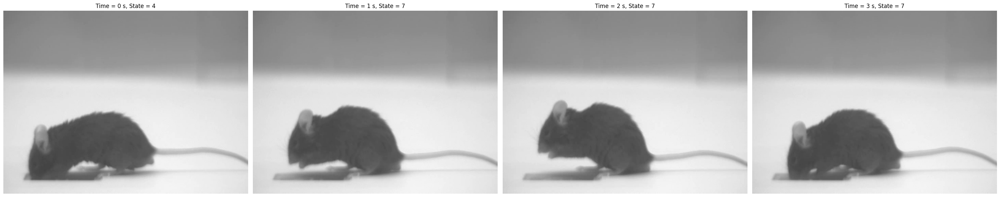

In [191]:
idx = [2, 8, 12, 61, 114, 161, 165, 244, 259, 274, 285, 289, 328, 390, 435, 440, 445, 448, 465, 489, 514, 600, 647, 678]
for t in idx:
    trigger = Mouse.arena.pellets.index[t]
    times = [0, 1, 2, 3]
    id = Mouse.arena.visits['start'].searchsorted(trigger, side='right') - 1
    patch = Mouse.arena.visits['patch'][id]
    
    fig, axs = plt.subplots(1,4,figsize = (30, 8))
    for i in range(len(times)):
        time = trigger + pd.Timedelta(str(times[i]) + "S")
        start, end = time, time + pd.Timedelta("1S")
        state = Mouse.mouse_pos.loc[start:end, 'state'][0] + 1
        if patch == 'Patch1':
            video_metadata = aeon.load(root, social02.CameraPatch1.Video, start=start, end=end)
        if patch == 'Patch2':
            video_metadata = aeon.load(root, social02.CameraPatch2.Video, start=start, end=end)
        if patch == 'Patch3':
            video_metadata = aeon.load(root, social02.CameraPatch3.Video, start=start, end=end)

        video_metadata.index = video_metadata.index.round("20L")
        frames = video.frames(video_metadata)
        first_frame = next(frames)
        rgb_frame = cv2.cvtColor(first_frame, cv2.COLOR_BGR2RGB)
        axs[i].imshow(rgb_frame)
        axs[i].set_title('Time = ' + str(times[i]) + ' s, State = ' + str(state))
        axs[i].axis('off')
    plt.tight_layout()
    #plt.savefig('../Images/Introduction/ArenaState5.png')
    plt.show()

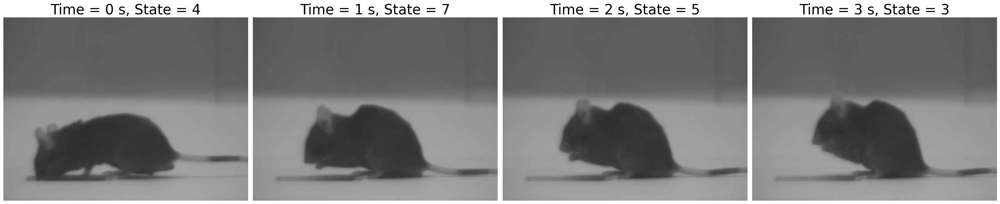

In [ ]:
fig, axs = plt.subplots(1,4,figsize = (30, 8))

times = [0, 1, 2, 3]
trigger = Mouse.arena.pellets.index[-6]
root = Mouse.root

states = Mouse.hmm.states
Mouse.mouse_pos['state'] = pd.Series(states, index = Mouse.mouse_pos.index)

for i in range(len(times)):
    time = trigger + pd.Timedelta(str(times[i]) + "S")
    start, end = time, time + pd.Timedelta("1S")
    state = Mouse.mouse_pos.loc[start:end, 'state'][0] + 1
    video_metadata = aeon.load(root, social02.CameraPatch3.Video, start=start, end=end)
    video_metadata.index = video_metadata.index.round("20L")
    frames = video.frames(video_metadata)
    first_frame = next(frames)
    rgb_frame = cv2.cvtColor(first_frame, cv2.COLOR_BGR2RGB)
    axs[i].imshow(rgb_frame)
    axs[i].set_title('Time = ' + str(times[i]) + ' s, State = ' + str(state), fontsize = 30)
    axs[i].axis('off')
plt.tight_layout()
#plt.savefig('../Images/Introduction/PelletDeliveryProcess.png')
plt.show()

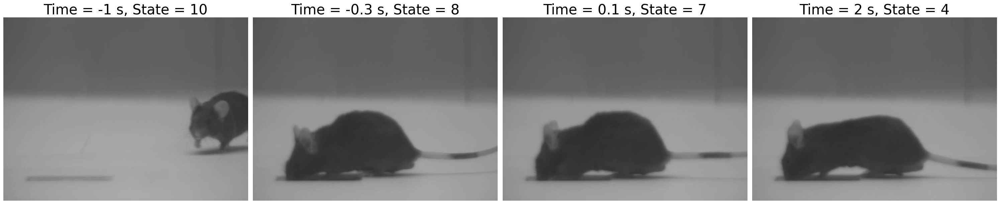

In [92]:
fig, axs = plt.subplots(1,4,figsize = (30, 8))

times = [-1, -0.3, 0.1, 2]
trigger = Mouse.arena.visits['start'].to_numpy()[-48]
root = Mouse.root

states = Mouse.hmm.states
Mouse.mouse_pos['state'] = pd.Series(states, index = Mouse.mouse_pos.index)

for i in range(len(times)):
    time = trigger + pd.Timedelta(str(times[i]) + "S")
    start, end = time, time + pd.Timedelta("1S")
    state = Mouse.mouse_pos.loc[start:end, 'state'][0] + 1
    video_metadata = aeon.load(root, social02.CameraPatch3.Video, start=start, end=end)
    video_metadata.index = video_metadata.index.round("20L")
    frames = video.frames(video_metadata)
    first_frame = next(frames)
    rgb_frame = cv2.cvtColor(first_frame, cv2.COLOR_BGR2RGB)
    axs[i].imshow(rgb_frame)
    axs[i].set_title('Time = ' + str(times[i]) + ' s, State = ' + str(state), fontsize = 30)
    axs[i].axis('off')
plt.tight_layout()
plt.show()